In [1]:
from IPython.display import display
from PIL import Image
import matplotlib.pyplot as plt
from skimage import io
import numpy as np
from sklearn.cluster import KMeans

/home/issa-sangare/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


In [9]:
from PIL import Image
import os

def details(path):
    img = Image.open(path)
    size = img.size
    format = img.format
    mode = img.mode
    resolution = img.info.get('dpi')
    definition = size[0] * size[1]
    definition2 = size
    size = (size[0]/ resolution[0], size[1] / resolution[1])
    # Calcul du poids de l'image
    poids = os.path.getsize(path) / (1000.0) # Converti en mégaoctets
    return size, format, mode, resolution[0], definition, definition2, poids

# Exemple d'utilisation
path_to_image = "eren_rgb.jpeg"
result = details(path_to_image)
print("Size (inch):", result[0])
print("Format:", result[1])
print("Mode:", result[2])
print("Resolution:", result[3])
print("Definition (pixels):", result[4])
print("Définition (L * C):", result[5])
print("Poids (taille en mémoire):", result[6], "Ko")

Size (inch): (4.2, 2.36)
Format: JPEG
Mode: RGB
Resolution: 300
Definition (pixels): 892080
Définition (L * C): (1260, 708)
Poids (taille en mémoire): 111.596 Ko


In [11]:
def create_color_palette(image, num_colors):
    # Convertir l'image en un tableau 2D de pixels
    pixels = np.reshape(image, (-1, 3))  # (nombre de pixels, 3 canaux de couleur)

    # Appliquer l'algorithme de k-means clustering
    kmeans = KMeans(n_clusters=num_colors)
    kmeans.fit(pixels)

    # Obtenir les centres des clusters (couleurs dominantes)
    color_palette = kmeans.cluster_centers_.astype(int)

    # Associer chaque pixel à l'indice de couleur dans la palette
    labels = kmeans.predict(pixels)

    # Reformater les indices des couleurs dans la palette selon la forme de l'image originale
    palette_indices = np.reshape(labels, image.shape[:2])

    return color_palette, palette_indices
  
# Charger l'image d'exemple
image = io.imread('eren_rgb.jpeg')

def reconstruct_image(color_palette, palette_indices):
    # Create an empty array to store the reconstructed image
    reconstructed_image = np.zeros((palette_indices.shape[0], palette_indices.shape[1], 3), dtype=np.uint8)

    # Map each palette index to its corresponding color in the color palette
    for i in range(color_palette.shape[0]):
        # Find pixels with the current palette index and assign the corresponding color
        reconstructed_image[palette_indices == i] = color_palette[i]

    return reconstructed_image


/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


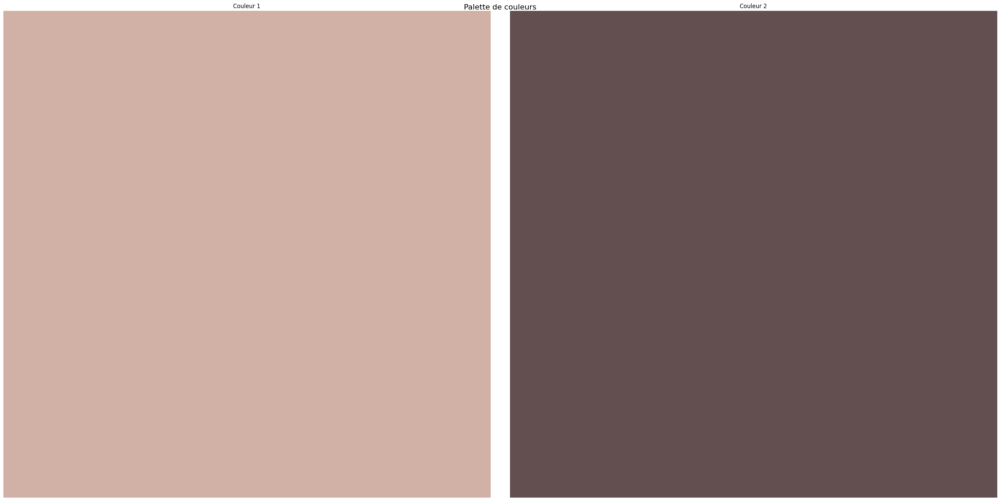

In [ ]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 2
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 1
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

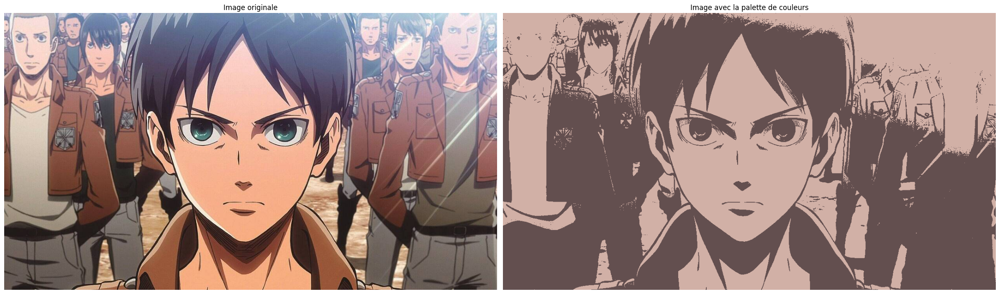

In [ ]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


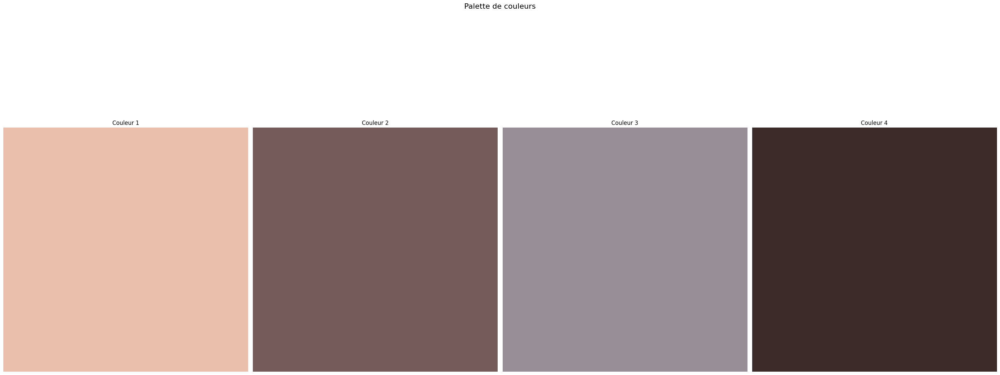

In [ ]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 4
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 1
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

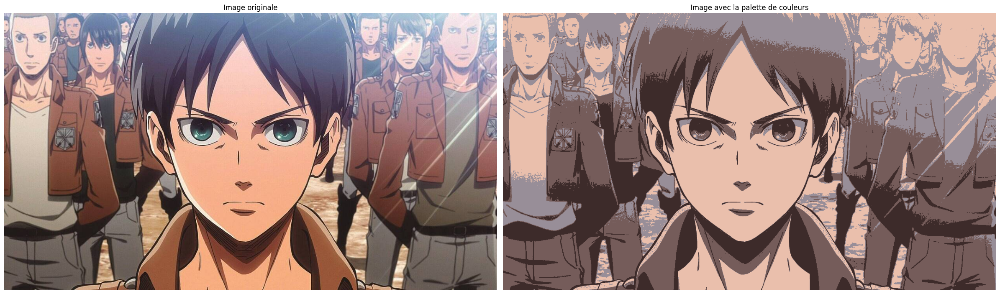

In [ ]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


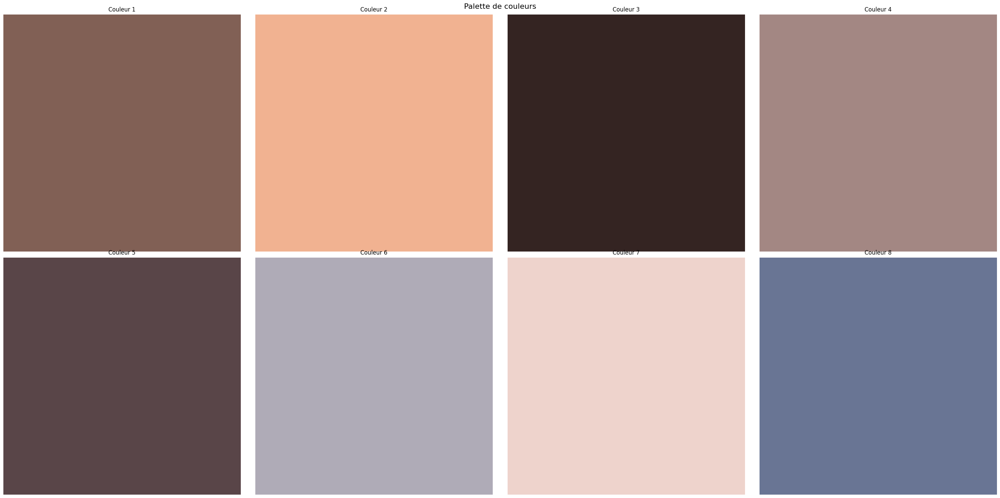

In [ ]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 8
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 2
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

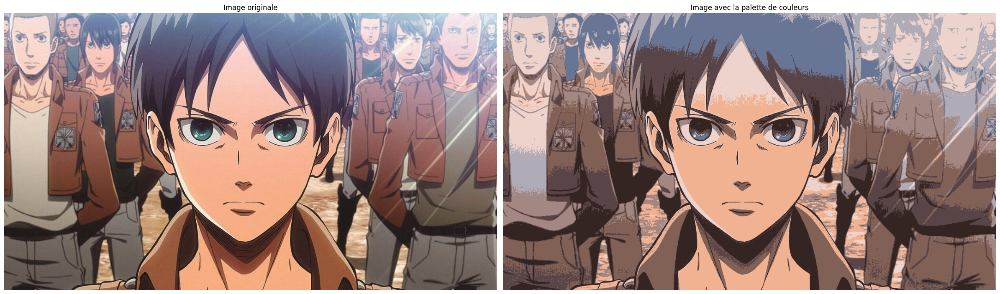

In [ ]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


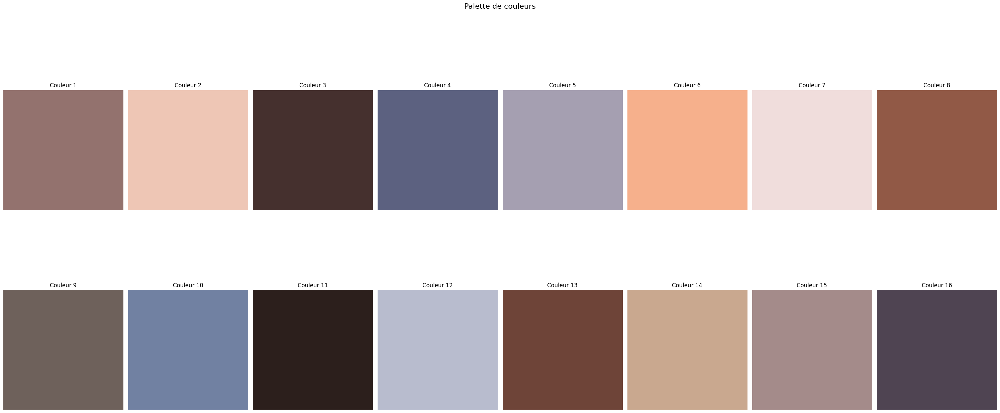

In [ ]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 16
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 2
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

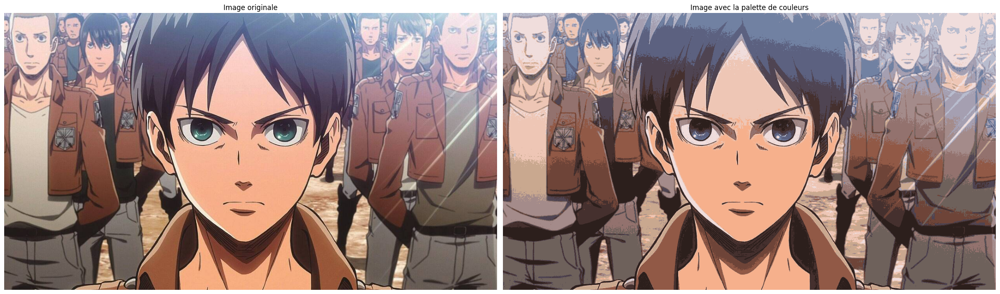

In [ ]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


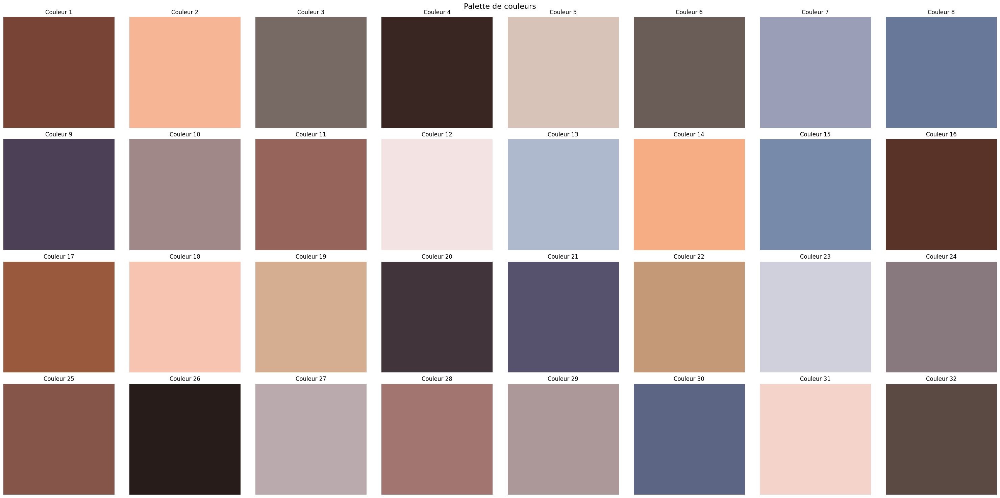

In [ ]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 32
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 4
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

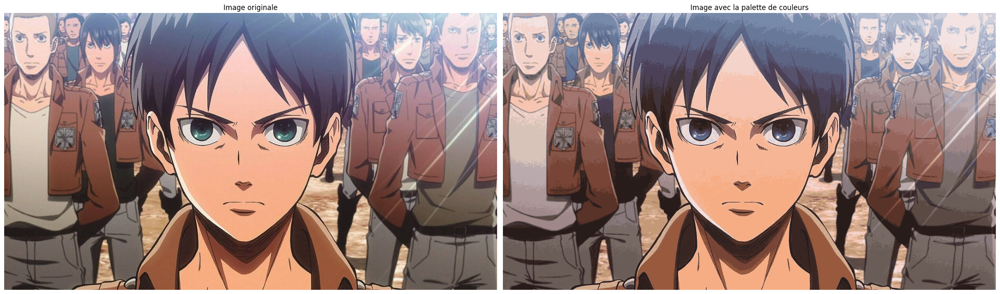

In [ ]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


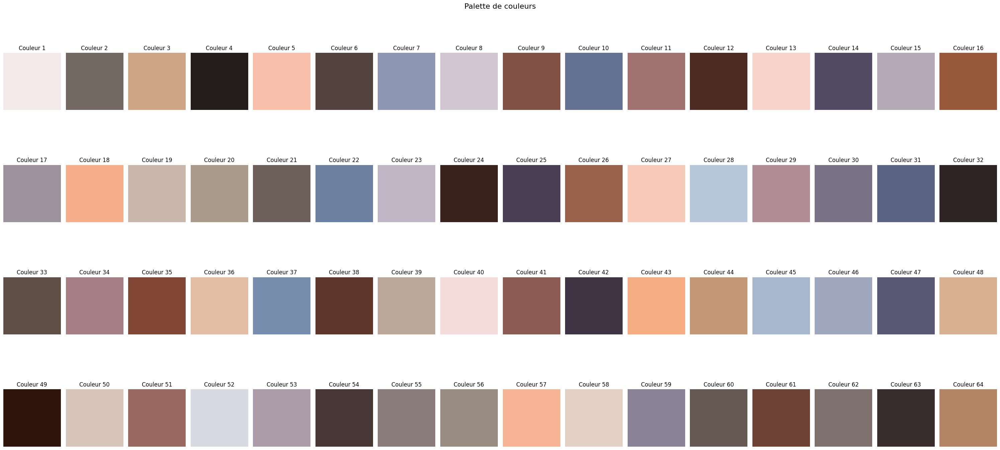

In [ ]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 64
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 4
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

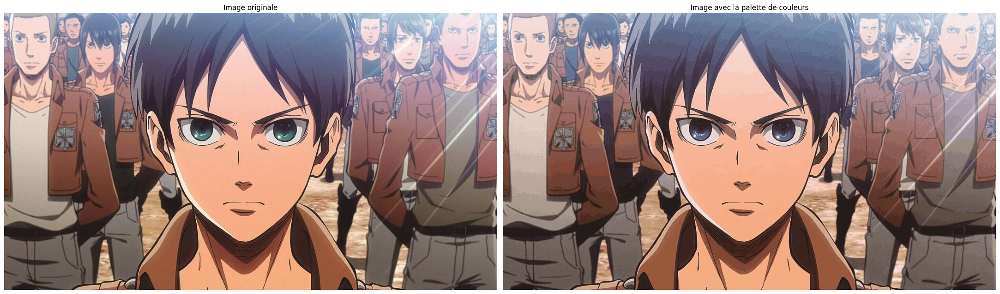

In [ ]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


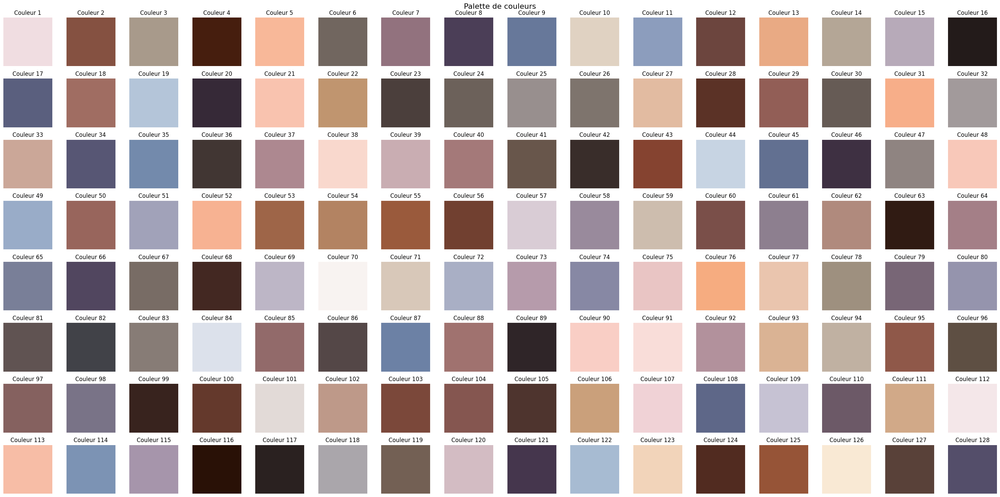

In [ ]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 128
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 8
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

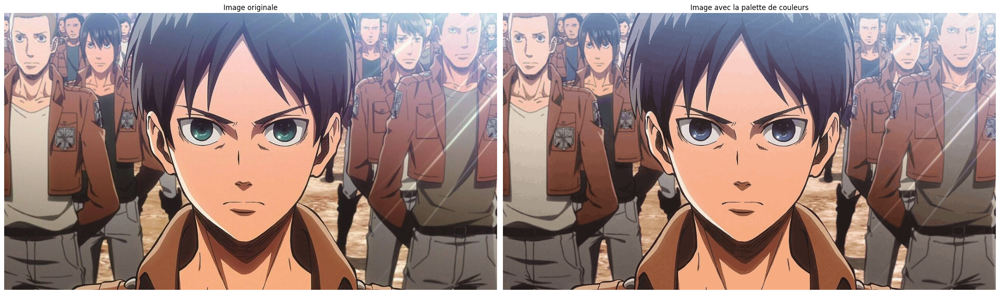

In [ ]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


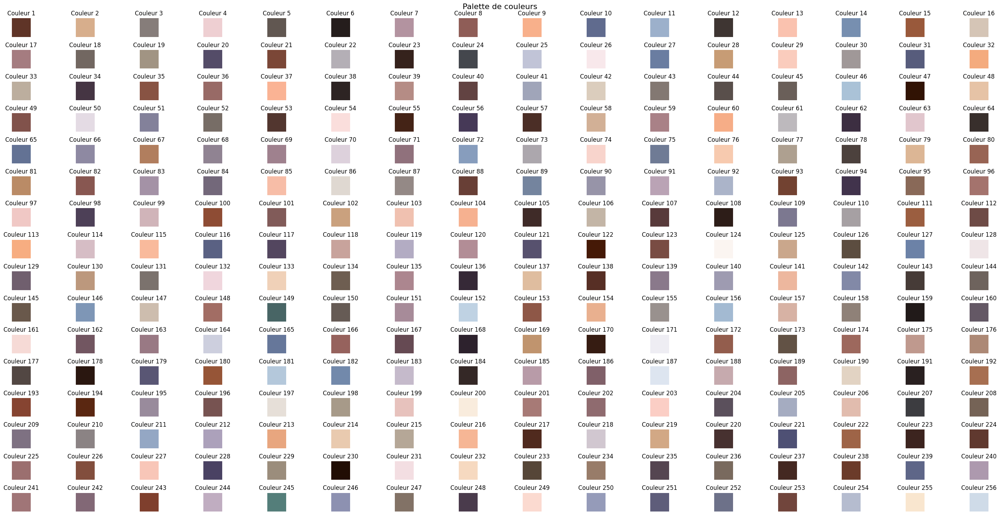

In [12]:
# Créer une palette de 5 couleurs à partir de l'image
num_colors = 256
color_palette, palette_indices = create_color_palette(image, num_colors)

# Afficher la palette de couleurs
num_rows = 16
num_cols = num_colors // num_rows
plt.figure(figsize=(30, 15))
for i, color in enumerate(color_palette):
    plt.subplot(num_rows, num_cols, i + 1)
    color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
    color_patch[:, :] = color
    plt.imshow(color_patch)
    plt.title(f'Couleur {i+1}')
    plt.axis('off')
plt.suptitle('Palette de couleurs', fontsize=16)
plt.tight_layout()
plt.show()

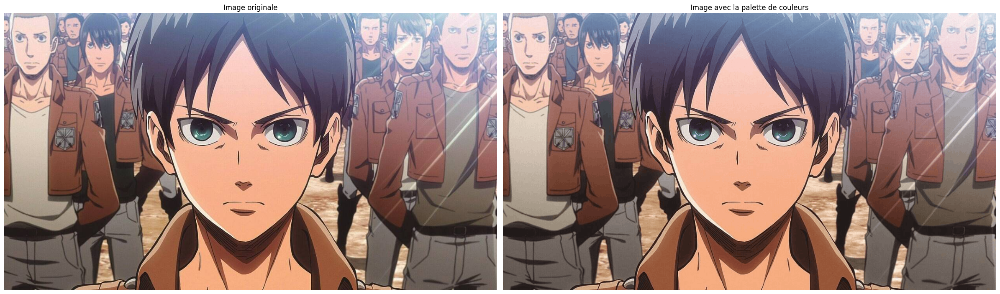

In [13]:
# Exemple d'utilisation :
image_path = "eren_rgb.jpeg"
image = io.imread(image_path)

reconstructed_image = reconstruct_image(color_palette, palette_indices)

fig, axs = plt.subplots(1, 2, figsize=(24, 10))

axs[0].imshow(image)
axs[0].set_title('Image originale')
axs[0].axis('off')

axs[1].imshow(color_palette[palette_indices])
axs[1].set_title('Image avec la palette de couleurs')
axs[1].axis('off')

fig.tight_layout()

plt.show()

In [ ]:
def map_image_to_palette(image, color_palette):
    # Convertir l'image en un tableau 2D de pixels
    pixels = np.reshape(image, (-1, 3))  # (nombre de pixels, 3 canaux de couleur)

    # Initialiser un tableau pour stocker les indices de la palette de couleur pour chaque pixel
    palette_indices = np.zeros(len(pixels), dtype=int)

    # Pour chaque pixel, trouver l'indice de la couleur la plus proche dans la palette
    for i, pixel in enumerate(pixels):
        distances = np.linalg.norm(color_palette - pixel, axis=1)  # Calculer les distances euclidiennes
        closest_color_index = np.argmin(distances)  # Trouver l'indice de la couleur la plus proche
        palette_indices[i] = closest_color_index

    # Reformater les indices des couleurs dans la palette selon la forme de l'image originale
    palette_indices = np.reshape(palette_indices, image.shape[:2])

    return palette_indices.flatten()
  
# Mapper l'image à la palette de couleurs
palette_indices = map_image_to_palette(image, color_palette)

# Afficher la palette d'indices associée à l'image
print("Palette d'indices de couleurs:")
for item in palette_indices:
    print(item)

Palette d'indices de couleurs:
235
57
114
114
152
57
57
152
57
57
152
152
152
57
187
187
195
125
114
124
248
100
99
124
137
166
125
229
18
166
229
134
125
125
134
134
134
134
134
134
93
93
93
93
93
93
93
125
166
134
134
134
134
134
134
134
96
125
134
134
134
134
134
166
134
134
134
134
134
134
134
134
134
134
134
134
229
229
134
134
134
134
134
134
134
134
134
134
166
166
134
134
134
134
134
134
125
134
134
166
166
134
134
134
134
125
125
134
166
134
134
134
134
134
125
125
125
134
134
134
125
134
134
134
134
125
134
134
114
192
152
61
195
249
207
53
249
61
61
57
114
56
56
56
56
34
56
56
56
56
124
124
56
56
124
56
56
56
56
192
34
65
226
249
249
10
10
10
10
10
10
10
10
10
10
249
249
53
53
53
53
249
249
249
207
176
176
207
226
61
195
144
195
195
61
152
114
152
152
152
57
18
56
56
56
196
196
196
56
56
56
56
56
56
56
34
114
34
220
152
61
53
53
249
10
10
249
249
249
53
53
53
84
84
200
200
200
200
200
200
200
200
200
200
200
200
200
200
200
200
200
200
84
84
200
200
200
200
53
249
249
10
10


In [ ]:
len(palette_indices)

892080

In [ ]:
palette_indices[0].shape

()

In [ ]:
def compress(data, alphabet):
    dictionary = {}
    result = []
    current_code = len(alphabet)

    # Initialiser le dictionnaire avec les caractères de l'alphabet spécifié
    for i, char in enumerate(alphabet):
        dictionary[char] = i

    prefix = data[0]
    for char in data[1:]:
        new_entry = prefix + char
        if new_entry in dictionary:
            prefix = new_entry
        else:
            result.append(dictionary[prefix])
            dictionary[new_entry] = current_code
            current_code += 1
            prefix = char
    
    print(dictionary)
    result.append(dictionary[prefix])
    return result

def decompress(compressed_data, alphabet):
    dictionary = {}
    result = []
    current_code = len(alphabet)

    # Initialiser le dictionnaire avec les caractères de l'alphabet spécifié
    for i, char in enumerate(alphabet):
        dictionary[i] = char

    old_entry = dictionary[compressed_data.pop(0)]
    result.append(old_entry)
    for new_entry in compressed_data:
        if new_entry in dictionary:
            entry = dictionary[new_entry]
        elif new_entry == current_code:
            entry = old_entry + old_entry[0]
        else:
            raise ValueError("Mauvaise séquence compressée")

        result.append(entry)

        dictionary[current_code] = old_entry + entry[0]
        current_code += 1
        old_entry = entry

    return ''.join(result)
  
# Générer l'alphabet de 0 à 255
alphabet = [str(i) for i in range(256)]
# Convertir la palette d'indices en une chaîne de caractères
palette_indices_str = ''.join(map(str, palette_indices.flatten()))

# Appliquer la compression à la palette d'indices
compressed_palette_indices = compress(palette_indices_str, alphabet)
print(alphabet)
print(palette_indices_str[0:500])
print(compressed_palette_indices)

{'0': 0, '1': 1, '2': 2, '3': 3, '4': 4, '5': 5, '6': 6, '7': 7, '8': 8, '9': 9, '10': 10, '11': 11, '12': 12, '13': 13, '14': 14, '15': 15, '16': 16, '17': 17, '18': 18, '19': 19, '20': 20, '21': 21, '22': 22, '23': 23, '24': 24, '25': 25, '26': 26, '27': 27, '28': 28, '29': 29, '30': 30, '31': 31, '32': 32, '33': 33, '34': 34, '35': 35, '36': 36, '37': 37, '38': 38, '39': 39, '40': 40, '41': 41, '42': 42, '43': 43, '44': 44, '45': 45, '46': 46, '47': 47, '48': 48, '49': 49, '50': 50, '51': 51, '52': 52, '53': 53, '54': 54, '55': 55, '56': 56, '57': 57, '58': 58, '59': 59, '60': 60, '61': 61, '62': 62, '63': 63, '64': 64, '65': 65, '66': 66, '67': 67, '68': 68, '69': 69, '70': 70, '71': 71, '72': 72, '73': 73, '74': 74, '75': 75, '76': 76, '77': 77, '78': 78, '79': 79, '80': 80, '81': 81, '82': 82, '83': 83, '84': 84, '85': 85, '86': 86, '87': 87, '88': 88, '89': 89, '90': 90, '91': 91, '92': 92, '93': 93, '94': 94, '95': 95, '96': 96, '97': 97, '98': 98, '99': 99, '100': 100, '101': 

In [ ]:
print(len(compressed_palette_indices))

In [ ]:
def MSE(image_d_origine, image_traitee):
    L, C = image_d_origine.size
    # Convertir les images en tableaux NumPy
    origine = np.array(image_d_origine)
    traitee = np.array(image_traitee)

    # Dimensions de la matrice
    #L, C = origine.shape

    # Calcul de la somme de la différence au carré
    somme_differences_carrees = np.sum((origine - traitee) ** 2)

    # Calcul de (1 / (L * C)) * somme
    resultat = (1 / (L * C)) * somme_differences_carrees

    return resultat


# Exemple d'utilisation avec deux matrices (image_nv_gris et image_amelioree)
erreur1 = MSE(Image.open('4.jpg'), reconstructed_image)
erreur2 = MSE(Image.open('4.jpg'), color_palette[palette_indices])
print(f"L'erreur quadratique moyenne 1 (MSE) est: {erreur1}")
print(f"L'erreur quadratique moyenne 2 (MSE) est: {erreur2}")

L'erreur quadratique moyenne 1 (MSE) est: 16.718615531921387
L'erreur quadratique moyenne 2 (MSE) est: 16.319802284240723


In [ ]:
def PSNR(image_d_origine, image_traitee):
    origine = np.array(image_d_origine)
    max_val = origine.max()

    return 10 * np.log10((max_val ** 2) / MSE(image_d_origine, image_traitee))

crete = PSNR(Image.open('4.jpg'), reconstructed_image)
print(f"Le rapport signal sur bruit de crête (PSNR) est: {crete}")

Le rapport signal sur bruit de crête (PSNR) est: 35.89880050189654


In [ ]:
def rle_encode(data):
    if not data:
        return ""

    encoded_data = ""
    current_value = data[0]
    count = 1

    for i in range(1, len(data)):
        if data[i] == current_value:
            count += 1
        else:
            if current_value < 0:
                encoded_data += str(current_value) + "*" + str(count)
            else:
                encoded_data += str(current_value)
            encoded_data += ","
            current_value = data[i]
            count = 1

    # Ajouter le traitement pour les dernières valeurs répétées
    if current_value < 0:
        encoded_data += str(current_value) + "*" + str(count)
    else:
        encoded_data += str(current_value)
    if count > 1:
        encoded_data += "*" + str(count)

    return encoded_data


# Example usage:
encoded_data = rle_encode(zigzag_scan)
print(encoded_data)


NameError: name 'zigzag_scan' is not defined

In [ ]:
def zigzag_traversal(matrix):
    if not matrix:
        return []

    rows = len(matrix)
    cols = len(matrix[0])
    result = []

    for i in range(rows + cols - 1):
        if i % 2 == 0:
            for j in range(max(0, i - rows + 1), min(cols, i + 1)):
                result.append(matrix[i - j][j])
        else:
            for j in range(max(0, i - cols + 1), min(rows, i + 1)):
                result.append(matrix[j][i - j])

    return result

def inverse_zigzag(vector, rows, cols):
    result = [[None] * cols for _ in range(rows)]
    row, col = 0, 0
    direction = 1

    for i in range(rows * cols):
        result[row][col] = vector[i]
        if direction == 1:
            if col == cols - 1:
                row += 1
                direction = -1
            elif row == 0:
                col += 1
                direction = -1
            else:
                row -= 1
                col += 1
        else:
            if row == rows - 1:
                col += 1
                direction = 1
            elif col == 0:
                row += 1
                direction = 1
            else:
                row += 1
                col -= 1

    return np.array(result, dtype=np.uint8)

# Exemple d'une matrice 4x4
matrix_4x4 = [
    [1, 2, 3, 4],
    [5, 6, 7, 8]
]

# Test de la fonction de parcours en zigzag
zigzag_result = zigzag_traversal(matrix_4x4)

# Test de la fonction de chemin inverse
reverse_matrix = inverse_zigzag(zigzag_result, 2, 4)


In [ ]:
np.array(matrix_4x4, dtype=np.uint8)

array([[1, 2, 3, 4],
       [5, 6, 7, 8]], dtype=uint8)

In [ ]:
zigzag_result

[1, 2, 5, 6, 3, 4, 7, 8]

In [ ]:
reverse_matrix

array([[1, 2, 3, 4],
       [5, 6, 7, 8]], dtype=uint8)

In [ ]:
from PIL import Image

# Créer une nouvelle image
image1 = Image.new("RGB", (100, 100), "red")
image2 = Image.new("RGB", (100, 100), "green")
image3 = Image.new("RGB", (100, 100), "blue")

# Créer une liste d'images clés
frames = [image1, image2, image3]

# Spécifier la durée d'affichage de chaque image clé (en millisecondes)
duration = 1000  # 1 seconde

# Enregistrer les images clés dans un fichier GIF animé
frames[0].save("animated.gif", format="GIF", append_images=frames[1:], save_all=True, duration=duration, loop=0)


In [ ]:
from PIL import Image
import os

# Chemin du dossier contenant les images JPEG
folder_path = "./dossier/"

# Liste pour stocker les images clés
frames = []

# Durée d'affichage de chaque image en millisecondes (1 minute = 60 secondes = 60000 millisecondes)
duration = 60000

# Charger toutes les images JPEG du dossier et les ajouter à la liste des images clés
for filename in sorted(os.listdir(folder_path)):
    if filename.endswith(".jpg"):
        image_path = os.path.join(folder_path, filename)
        img = Image.open(image_path)
        frames.append(img)

# Enregistrer les images clés dans un fichier GIF animé
frames[0].save("animation.gif", format="GIF", append_images=frames[1:], save_all=True, duration=duration, loop=0)


[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

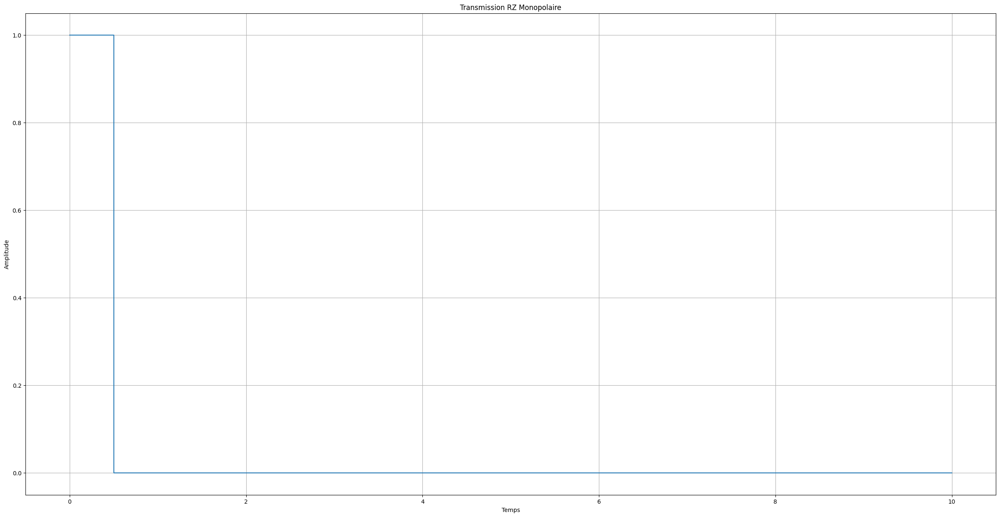

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Données
bits = '1010101110'

# Paramètres de l'impulsion
T = 1  # Durée de bit
sample_rate = 100  # Échantillons par période de bit
t = np.linspace(0, len(bits), len(bits) * sample_rate)

# Signal
signal = np.zeros(len(t))

for i, bit in enumerate(bits):
    if bit == '1':
        signal[i*sample_rate:(i+1)*sample_rate//2] = 1  # Impulsion pour la moitié de la période pour '1'
        print(signal)

# Tracé du signal
plt.figure(figsize=(30, 15))
plt.plot(t, signal, drawstyle='steps-post')
plt.title('Transmission RZ Monopolaire')
plt.xlabel('Temps')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()


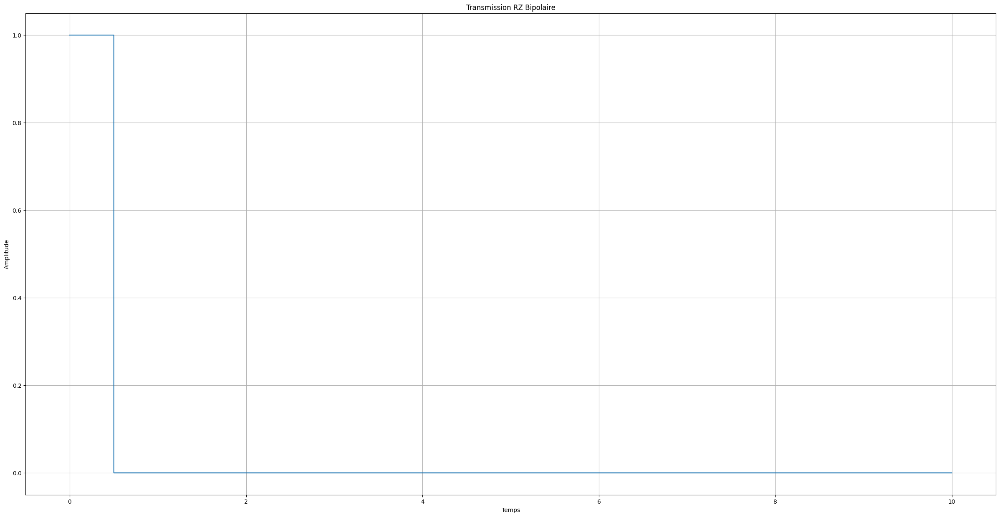

In [ ]:
# Continuation du code précédent

# Paramètres supplémentaires pour RZ bipolaire
last_bit_one = False  # Pour suivre la polarité du dernier bit '1'

for i, bit in enumerate(bits):
    if bit == '1':
        if last_bit_one:
            signal[i*sample_rate:(i+1)*sample_rate//2] = -1  # Impulsion négative
            last_bit_one = False
        else:
            signal[i*sample_rate:(i+1)*sample_rate//2] = 1  # Impulsion positive
            last_bit_one = True

# Tracé du signal RZ Bipolaire
plt.figure(figsize=(30, 15))
plt.plot(t, signal, drawstyle='steps-post')
plt.title('Transmission RZ Bipolaire')
plt.xlabel('Temps')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()


In [ ]:
# Continuation du code précédent

# Signal NRZ
signal = np.zeros(len(t))

for i, bit in enumerate(bits):
    if bit == '1':
        signal[i*sample_rate:(i+1)*sample_rate] = 1  # Tension constante pour '1'

# Tracé du signal NRZ
plt.figure(figsize=(30, 15))
plt.plot(t, signal, drawstyle='steps-post')
plt.title('Transmission NRZ')
plt.xlabel('Temps')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()


TypeError: 'str' object does not support item assignment

In [ ]:
def encode_nrz_int(data):
    """Encode une séquence binaire en utilisant le schéma NRZ, avec des entiers."""
    # NRZ: '1' = +1, '0' = -1
    return [1 if bit == '1' else -1 for bit in data]

def encode_rtz_monopolaire_int(data):
    """Encode une séquence binaire en utilisant le schéma RTZ monopolaire, avec des entiers."""
    # RTZ Monopolaire: '1' = [+1, 0], '0' = [0, 0]
    encoded = []
    for bit in data:
        if bit == '1':
            encoded.extend([1, 0])
        else:
            encoded.extend([0, 0])
    return encoded

def encode_rtz_bipolaire_int(data):
    """Encode une séquence binaire en utilisant le schéma RTZ bipolaire, avec des entiers."""
    # RTZ Bipolaire: alterne entre +1 et -1 pour '1', suivi par 0, '0' = [0, 0]
    encoded = []
    last_bit = -1
    for bit in data:
        if bit == '1':
            last_bit = -last_bit  # Alterne entre 1 et -1
            encoded.extend([last_bit, 0])
        else:
            encoded.extend([0, 0])
    return encoded

# Exemple de séquence binaire
binary_data = "11001010"

# Affichage des résultats avec des entiers
print("Séquence binaire originale :", binary_data)
print("NRZ              :", encode_nrz_int(binary_data))
print("RTZ Monopolaire  :", encode_rtz_monopolaire_int(binary_data))
print("RTZ Bipolaire    :", encode_rtz_bipolaire_int(binary_data))


Séquence binaire originale : 11001010
NRZ              : [1, 1, -1, -1, 1, -1, 1, -1]
RTZ Monopolaire  : [1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0]
RTZ Bipolaire    : [1, 0, -1, 0, 0, 0, 0, 0, 1, 0, 0, 0, -1, 0, 0, 0]
